# Import The Library Of Panda Numpy Seaborn

In [1]:
import pandas as pd
import numpy as np
pd.set_option('max_rows', 15)
pd.plotting.register_matplotlib_converters()
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
print("Loading The Pandas , Numpy And Seaborn")

Loading The Pandas , Numpy And Seaborn


## Load The Data File Of The Lending Club (LendingClubLoans2018-2020.csv)

In [2]:
pd.options.display.max_rows = 120

# Defining The Dataset File Path 
Lending_Data_Path = "C:/Users/Patrick-Pc/Documents/Python_Workspace/Data_Mining_CW2/LendingClubLoans2018-2020.csv"

#Loading The Data Using The Panda Lib.
Lending_Data = pd.read_csv(Lending_Data_Path)


## Lets Check The Total Rows And Columns In The Data Set

In [3]:
Lending_Data.shape

(77159, 108)

## Find Count And Name Of The Numeric Column Name From Dataset

In [4]:
print(f"Find The Count Of The Numeric Colmun {len(Lending_Data.select_dtypes(include=np.number).columns)} \n")

print(Lending_Data.select_dtypes(include='number').columns.tolist)

Find The Count Of The Numeric Colmun 86 

<bound method IndexOpsMixin.tolist of Index(['id', 'loan_amnt', 'installment', 'annual_inc', 'annual_inc_joint',
       'dti', 'dti_joint', 'delinq_2yrs', 'inq_fi', 'inq_last_12m',
       'inq_last_6mths', 'fico_range_low', 'fico_range_high',
       'last_fico_range_high', 'last_fico_range_low', 'mort_acc', 'open_acc',
       'open_acc_6m', 'acc_open_past_24mths', 'pub_rec', 'total_acc',
       'out_prncp', 'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv',
       'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'total_cu_tl',
       'tot_coll_amt', 'tot_cur_bal', 'total_bal_il', 'total_rev_hi_lim',
       'tot_hi_cred_lim', 'total_bal_ex_mort', 'total_bc_limit',
       'total_il_high_credit_limit', 'mths_since_last_record',
       'mths_since_last_major_derog', 'mths_since_recent_bc',
       'mths_since_recent_bc_dlq', 'mths_since_recent_inq',
       'mths_since_rcnt_il', 'mths_since_last_delinq',
       'mths_since_recent_revol_delin

## Find Count And Name Of The Cateogorical Column From Dataset.

In [5]:
print(f"Find The Count Of The Cateogorical Colmun {len(Lending_Data.select_dtypes(exclude=np.number).columns)} \n")

print(Lending_Data.select_dtypes(exclude=np.number).columns.tolist)

Find The Count Of The Cateogorical Colmun 22 

<bound method IndexOpsMixin.tolist of Index(['emp_title', 'application_type', 'home_ownership', 'loan_status',
       'int_rate', 'term', 'grade', 'earliest_cr_line', 'issue_d',
       'last_pymnt_d', 'next_pymnt_d', 'verification_status',
       'verification_status_joint', 'pymnt_plan', 'purpose', 'hardship_flag',
       'hardship_reason', 'hardship_type', 'hardship_status',
       'payment_plan_start_date', 'initial_list_status', 'revol_util'],
      dtype='object')>


## Lets Find The Missing Data Count In Each Column Using data frame isNull function and then sum all the values.

In [6]:
Lending_Data.isnull().sum().sort_values(ascending=False).head(15)

hardship_status                               72668
payment_plan_start_date                       72668
hardship_reason                               72668
hardship_type                                 72668
deferral_term                                 72668
orig_projected_additional_accrued_interest    71170
hardship_last_payment_amount                  71042
hardship_amount                               71042
hardship_payoff_balance_amount                71042
verification_status_joint                     67780
dti_joint                                     67777
revol_bal_joint                               67777
annual_inc_joint                              67777
mths_since_last_record                        65802
mths_since_recent_bc_dlq                      59765
dtype: int64

## Lets Calculate The Percentage Of The Missing Value Of Every Column And Sort In Descending Order

In [7]:
def find_missing_value(data_set):
    percent_missing = data_set.isnull().sum() * 100 / len(data_set)
    missing_value_df = pd.DataFrame({'column_name': data_set.columns,'percent_missing': percent_missing})
    missing_value_df=missing_value_df.sort_values('percent_missing', ascending=False)
    
    return missing_value_df

In [8]:
find_missing_value(Lending_Data).head(15)

,column_name,percent_missing
deferral_term,deferral_term,94.179551
payment_plan_start_date,payment_plan_start_date,94.179551
hardship_status,hardship_status,94.179551
hardship_type,hardship_type,94.179551
hardship_reason,hardship_reason,94.179551
orig_projected_additional_accrued_interest,orig_projected_additional_accrued_interest,92.238106
hardship_last_payment_amount,hardship_last_payment_amount,92.072215
hardship_payoff_balance_amount,hardship_payoff_balance_amount,92.072215
hardship_amount,hardship_amount,92.072215
verification_status_joint,verification_status_joint,87.844581


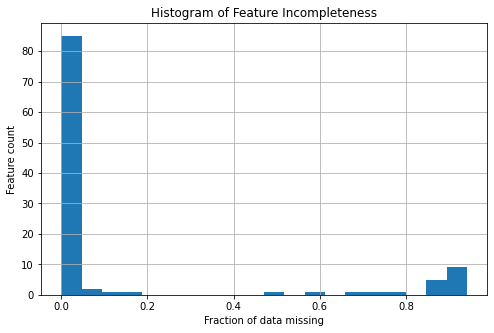

In [9]:
plt.figure(figsize=(8,5))
(Lending_Data.isna().sum() / Lending_Data.shape[0]).hist(bins=20)
plt.title('Histogram of Feature Incompleteness')
plt.xlabel('Fraction of data missing')
plt.ylabel('Feature count');

### From The Above Histo-Gram We can see that So Many Columns have missing values above 10% and other are below 10%

## Calculate The Total Percentage Of The Missing Data.

In [10]:
# Function To Calculate The Over All Percentage Of Missing Value
def find_total_perc_missing (data_set):
    temp_missing_val = (data_set.isnull().sum()).sum()
    total_cel = np.product(data_set.shape)
    perc_missing_data=100 * (temp_missing_val/total_cel)
    return perc_missing_data

In [11]:
print(find_total_perc_missing(Lending_Data))

15.70667208117149


# Data Cleaning

### Cleaning The Missing Values. As Per Assignment , We Are Going To Drop The 60% Missing Value Column.By creating an loop to drop Column by name with 60% missed values.

In [12]:
def remove_columns (data_set,final_val_data):
    list_remove_column=[]
    for index,row in final_val_data.iterrows():
        if row['percent_missing'] > 60:
            if index in Lending_Data.columns:
                list_remove_column.append(index)
    return list_remove_column

In [13]:
# calling the above function to find the list of above 60
Removed_Column_Name=remove_columns(Lending_Data,find_missing_value(Lending_Data))
Lending_Data=Lending_Data.drop(Removed_Column_Name, axis=1)

In [14]:
#Lending_Data=Lending_Data.drop(columns=['recoveries','collection_recovery_fee','total_rec_late_fee','inq_last_6mths'])
print(Lending_Data.initial_list_status.unique()) 
print(Lending_Data.pymnt_plan.unique()) 
print(Lending_Data.mths_since_last_delinq.unique(),"Missing Value Count:",Lending_Data.mths_since_last_delinq.isnull().sum()) 
print(Lending_Data.id.unique()) 
print(Lending_Data.emp_title.unique()) 

['w' 'f']
['n']
[ 34.  nan  68.  64.  18.  31.  79.   8.  77.  24.  30.  16.   3.  14.
  83.  47.   7.  13.  23.  35.   6.  45.  43.  21.  25.   5.  12.  51.
  37.  26.  11.  17.  40.  29.  38.  44.  39.  59.  49.  33.  57.  19.
  74.  66.  20.   9.  73.   2.  54.  32.  63.   4.  75.  28.  58.  80.
  53.  55.  76.  41.  10.  70.  42.  61.  48.  69.  46.  36.  72.  15.
  60.  22.  67.  62.  27.  56.  50.   1.  52.  71.  82.  65.  81.  78.
   0. 102.  99. 131.  91.  86.  94.  88. 101. 103.  93. 100.  90. 107.
  84.  97.  89.  92.  96. 122. 105. 111. 112.  98. 150.  87.  95. 115.
 146. 110. 123. 126. 109. 142. 128. 127. 125. 118. 116.  85.] Missing Value Count: 39645
[113924213 113101099 113672609 ... 125555899 117270963 117596312]
['Stagehand' 'Detention Deputy' nan ... 'IT analyst'
 'Principal IA Engineer' 'strander']


### In Our Analysis Column ID And Emp_Title Is No Use.So We Can Drop Them

In [15]:
Lending_Data=Lending_Data.drop(columns=['id','emp_title'],axis=1)

### Lets Remove The Uncategorised Column Having No Significance During Analysis
### As We Can See next_pymnt_d column value related to current loan_status.So We Are Dropping This Value As Well

In [16]:
#We have identified multiple columns which may not useful for analysis as they have same type of data.
Lending_Data=Lending_Data.drop(columns=['initial_list_status','pymnt_plan','mths_since_last_delinq','next_pymnt_d'])

### As We Conclude From Above Graph, Loan with status ChargedOff,Current and Fully Paid Took the most nulber of loans.As Of Now We Only Work On The ChargedOff And FullyPaid Status.

In [17]:
Lending_Data.loan_status.unique()

array(['Fully Paid', 'Charged Off', 'Current', 'In Grace Period',
       'Late (31-120 days)', 'Late (16-30 days)', 'Default'], dtype=object)

### Change Data To Charged Off As Bad Loan other than that we have good loan named as Fully Paid.

In [18]:
Lending_Data['loan_status']=Lending_Data['loan_status'].replace(['In Grace Period','Late (31-120 days)', 'Late (16-30 days)', 'Default'],'Charged Off')

### After Deletion Of The Column , Now We Check The Shape Of The Dataset Again

In [19]:
Lending_Data.shape

(77159, 85)

## In the above step , We see the from 108 column to 91 are remaining after removal of missing value. Now we use the describe function.

In [20]:
Lending_Data.describe()

,loan_amnt,installment,annual_inc,dti,delinq_2yrs,inq_fi,inq_last_12m,inq_last_6mths,fico_range_low,fico_range_high,...,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens
count,77159.000000,77159.000000,7.715900e+04,77051.000000,77159.000000,74664.000000,74664.000000,77159.000000,77159.000000,77159.000000,...,77159.000000,77159.000000,77159.000000,77159.000000,77159.000000,77159.000000,77154.000000,76040.000000,77159.000000,77159.000000
mean,15156.519978,443.024291,7.836316e+04,19.690700,0.321012,0.967709,1.943641,0.497635,701.786247,705.786558,...,8.014438,12.965228,5.365142,11.430565,0.086354,1.948120,93.762679,38.434283,0.127866,0.038829
std,9749.195616,279.917146,8.492549e+04,21.589715,0.932101,1.431024,2.257943,0.792988,34.730335,34.731622,...,4.747998,7.772846,3.281323,5.738928,0.570806,1.778157,9.761986,36.271699,0.346214,0.352836
min,1000.000000,7.610000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,660.000000,664.000000,...,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,7.900000,0.000000,0.000000,0.000000
25%,7800.000000,239.520000,4.500000e+04,11.960000,0.000000,0.000000,0.000000,0.000000,675.000000,679.000000,...,5.000000,7.000000,3.000000,7.000000,0.000000,1.000000,90.900000,0.000000,0.000000,0.000000
50%,12175.000000,368.900000,6.500000e+04,18.080000,0.000000,0.000000,1.000000,0.000000,695.000000,699.000000,...,7.000000,11.000000,5.000000,10.000000,0.000000,2.000000,100.000000,33.300000,0.000000,0.000000
75%,20000.000000,591.285000,9.400000e+04,25.010000,0.000000,1.000000,3.000000,1.000000,720.000000,724.000000,...,10.000000,17.000000,7.000000,14.000000,0.000000,3.000000,100.000000,66.700000,0.000000,0.000000
max,40000.000000,1717.630000,1.099920e+07,999.000000,36.000000,21.000000,35.000000,6.000000,845.000000,850.000000,...,63.000000,107.000000,39.000000,74.000000,36.000000,23.000000,100.000000,100.000000,6.000000,44.000000


## Lets Again Check The Amount Of Missing Values And Percentage In The Data

In [21]:
find_missing_value(Lending_Data).head(10)

,column_name,percent_missing
il_util,il_util,17.187885
mths_since_recent_inq,mths_since_recent_inq,11.979160
mths_since_rcnt_il,mths_since_rcnt_il,6.323306
all_util,all_util,3.254319
open_acc_6m,open_acc_6m,3.233583
open_rv_24m,open_rv_24m,3.233583
open_rv_12m,open_rv_12m,3.233583
total_bal_il,total_bal_il,3.233583
inq_last_12m,inq_last_12m,3.233583
open_act_il,open_act_il,3.233583


### Check Weather All The Values Of Rows Is Null

In [22]:
print('Lending Data',Lending_Data.isnull().all(axis=0).sum())

Lending Data 0


### Now checking whether we have any row having more than NaN or Null value 

In [23]:
print("Lending Data",len(Lending_Data[Lending_Data.isnull().sum(axis=1)>14].index))

Lending Data 416


In [24]:
Lending_Data= Lending_Data.drop(Lending_Data[Lending_Data.isnull().sum(axis=1)>14].index)

## Lets Convert As Much As Columns Into Numeric Form

### we have column 'term' having all the values in the form of month.Now We Can parse the numeric value from the column and change the title as well. Using the lamda function to split the value and overwrite it in same dataset.

In [25]:
# Split The Value And Only Use The First Index Numric Value
Lending_Data['term']=Lending_Data['term'].astype(str).apply(lambda x:x.split(' ')[0])
# Rename The Column Name So We Can Relate The Value Easily
Lending_Data['term']=Lending_Data['term'].astype(float)
Lending_Data=Lending_Data.rename(columns={'term': 'term_in_month'})

### We Have Two Columns 'int_rate' And 'revol_util'.Both Column Can Also Converted Into Numaric Value By Removing The % Symbol.

In [26]:
#Now removing the % symbol from interest rate and revol_util columns
Lending_Data['int_rate']=Lending_Data['int_rate'].astype(str).apply(lambda x:x.split('%')[0])
Lending_Data['revol_util']=Lending_Data['revol_util'].astype(str).apply(lambda x:x.split('%')[0])
Lending_Data.head()

,application_type,home_ownership,loan_status,loan_amnt,int_rate,term_in_month,installment,grade,earliest_cr_line,issue_d,...,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens
0,Individual,RENT,Fully Paid,35000,15.05,36.0,1214.15,C,Jan-01,01-08-2017,...,5,6,5,7,0,1,80.0,0.0,0,0
1,Individual,RENT,Charged Off,21000,14.08,60.0,489.51,C,Dec-00,01-07-2017,...,10,11,5,13,0,1,100.0,33.3,1,0
2,Individual,MORTGAGE,Current,20000,14.08,60.0,466.20,C,Apr-86,01-07-2017,...,12,17,7,14,0,2,100.0,18.2,0,0
3,Individual,RENT,Fully Paid,16000,19.03,36.0,586.74,D,Feb-90,01-08-2017,...,8,27,8,10,0,2,95.7,75.0,1,0
4,Individual,MORTGAGE,Fully Paid,24000,8.90,60.0,497.04,A,Mar-88,01-08-2013,...,7,11,4,12,0,1,100.0,0.0,0,0


### Now Convert The Datatype Of The Above Column To Float ('int_rate', 'revol_util')

In [27]:
#now convert dtype for int_rate and revol_util to float
Lending_Data['int_rate']=Lending_Data['int_rate'].astype(float)
Lending_Data['revol_util']=Lending_Data['revol_util'].astype(float)

### Lets Work On The Date Variables. Change the datatype and format all the column into same sequence.

### Lets Check The Date Format Of The Columns

In [28]:
# First 3 Column Have Same Date Format And Last One Have Different.
print(f"earliest_cr_line {Lending_Data.earliest_cr_line.head(3)}{Lending_Data.earliest_cr_line.dtype}")
print(f"issue_d {Lending_Data.issue_d.head(3)}{Lending_Data.issue_d.dtype}")
print(f"last_pymnt_d {Lending_Data.last_pymnt_d.head(3)}{Lending_Data.last_pymnt_d.dtype}")

earliest_cr_line 0    Jan-01
1    Dec-00
2    Apr-86
Name: earliest_cr_line, dtype: objectobject
issue_d 0    01-08-2017
1    01-07-2017
2    01-07-2017
Name: issue_d, dtype: objectobject
last_pymnt_d 0    01-04-2020
1    01-06-2019
2    01-05-2020
Name: last_pymnt_d, dtype: objectobject


In [29]:
Lending_Data['issue_d'] = pd.to_datetime(Lending_Data['issue_d'],format='%d-%m-%Y')
Lending_Data['earliest_cr_line'] = pd.to_datetime(Lending_Data['earliest_cr_line'],format='%b-%y')
Lending_Data['last_pymnt_d'] = pd.to_datetime(Lending_Data['last_pymnt_d'], format='%d-%m-%Y')

In [30]:
print(f"earliest_cr_line {Lending_Data.earliest_cr_line.head(1)}{Lending_Data.earliest_cr_line.dtype}")
print(f"issue_d {Lending_Data.issue_d.head(1)}{Lending_Data.issue_d.dtype}")
print(f"last_pymnt_d {Lending_Data.last_pymnt_d.head(1)}{Lending_Data.last_pymnt_d.dtype}")

earliest_cr_line 0   2001-01-01
Name: earliest_cr_line, dtype: datetime64[ns]datetime64[ns]
issue_d 0   2017-08-01
Name: issue_d, dtype: datetime64[ns]datetime64[ns]
last_pymnt_d 0   2020-04-01
Name: last_pymnt_d, dtype: datetime64[ns]datetime64[ns]


In [31]:
#Lets Rename The Column Name For Better Understanding
Lending_Data=Lending_Data.rename(columns={'issue_d':'issue_date','last_pymnt_d':'last_pymnt_date'})                            
Lending_Data.head(2)

,application_type,home_ownership,loan_status,loan_amnt,int_rate,term_in_month,installment,grade,earliest_cr_line,issue_date,...,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens
0,Individual,RENT,Fully Paid,35000,15.05,36.0,1214.15,C,2001-01-01,2017-08-01,...,5,6,5,7,0,1,80.0,0.0,0,0
1,Individual,RENT,Charged Off,21000,14.08,60.0,489.51,C,2000-12-01,2017-07-01,...,10,11,5,13,0,1,100.0,33.3,1,0


### Lets Seprate The Date Columns And Create New                 

In [32]:
Lending_Data['earliest_cr_line_year']=Lending_Data['earliest_cr_line'].dt.year
Lending_Data['earliest_cr_line_month']=Lending_Data['earliest_cr_line'].dt.month
Lending_Data['issue_date_year']=Lending_Data['issue_date'].dt.year
Lending_Data['issue_date_month']=Lending_Data['issue_date'].dt.month

### Using The Below Command We have found in earliest_cr_line_year columns have multiple entries which have year greater than 2021.So we refer back to the old file and found these dates
### have 100 years of difference.

In [33]:
len(Lending_Data[Lending_Data['earliest_cr_line_year'] > 2021 ])

146

In [34]:
#Now correcting the Year for the above 79 values
Lending_Data.loc[Lending_Data['earliest_cr_line_year'] > 2021 , 'earliest_cr_line_year'] = Lending_Data['earliest_cr_line_year'] - 100

### We Are Checking This For Issue Date Year Column As Well and the output is zero

In [35]:
len(Lending_Data[Lending_Data['issue_date_year'] > 2021 ])

0

### After All The Conversion And Parsing Of Date Remove The Duplicate Columns

In [36]:
Lending_Data = Lending_Data.drop(columns=['earliest_cr_line', 'issue_date', 'last_pymnt_date'])

### Now We Are Imputing All The Remaining Columns, Using TransformerMixin ###

In [37]:
from sklearn.base import TransformerMixin

class DataFrameImputer(TransformerMixin):

    def __init__(self):
        """Impute missing values.

        Columns of dtype object are imputed with the most frequent value 
        in column.

        Columns of other types are imputed with mean of column.

        """
    def fit(self, X, y=None):
        # Find most common value with value_counts() which returns 
        # counts in descending order so that the first element is the most frequently-occurring element.
        self.fill = pd.Series([X[c].value_counts().index[0]
            #Use that if type is object otherwise use mean                   
            if X[c].dtype == np.dtype('O') else X[c].mean() for c in X],
            index=X.columns)

        return self

    def transform(self, X, y=None):
        return X.fillna(self.fill)


In [38]:
#Calling The Impute Fuction To Fill Null Values
Lending_Data = DataFrameImputer().fit_transform(Lending_Data)
find_missing_value(Lending_Data).head()

,column_name,percent_missing
application_type,application_type,0.0
bc_util,bc_util,0.0
recoveries,recoveries,0.0
bc_open_to_buy,bc_open_to_buy,0.0
avg_cur_bal,avg_cur_bal,0.0


In [39]:
print(f"Find The Count Of The Cateogorical Colmun {len(Lending_Data.select_dtypes(exclude=np.number).columns)} \n")

print(Lending_Data.select_dtypes(exclude=np.number).columns.tolist)

Find The Count Of The Cateogorical Colmun 7 

<bound method IndexOpsMixin.tolist of Index(['application_type', 'home_ownership', 'loan_status', 'grade',
       'verification_status', 'purpose', 'hardship_flag'],
      dtype='object')>


### Lets Encode The Categorical Columns After Converting The Some Important Columns Manually.

In [40]:
from sklearn import preprocessing
import category_encoders as ce

def encode_category_data(dataset_var):
       #We establish the Ordinal encoder which will convert each categorical label to a number
       # We specify the columns we want to transform, we ask it to handle missing values if any and also to return a dataframe                     instead of an np array
       encode_var = ce.OrdinalEncoder(cols=['application_type', 'home_ownership', 'loan_status', 'grade',
       'verification_status', 'purpose', 'hardship_flag'],handle_missing='return_nan',return_df= True)
       dataset_var=encode_var.fit_transform(dataset_var)
       return dataset_var

In [41]:
#We now fit the model and transform the data and put it in X which is a dataframe
Lending_Data=encode_category_data(Lending_Data)

C:\Users\Patrick-Pc\anaconda3\lib\site-packages\category_encoders\utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


In [42]:
Lending_Data.groupby('loan_status').count()

,application_type,home_ownership,loan_amnt,int_rate,term_in_month,installment,grade,annual_inc,verification_status,purpose,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,earliest_cr_line_year,earliest_cr_line_month,issue_date_year,issue_date_month
loan_status,,,,,,,,,,,,,,,,,,,,,
1.0,33889,33889,33889,33889,33889,33889,33889,33889,33889,33889,...,33889,33889,33889,33889,33889,33889,33889,33889,33889,33889
2.0,10815,10815,10815,10815,10815,10815,10815,10815,10815,10815,...,10815,10815,10815,10815,10815,10815,10815,10815,10815,10815
3.0,32039,32039,32039,32039,32039,32039,32039,32039,32039,32039,...,32039,32039,32039,32039,32039,32039,32039,32039,32039,32039


### Applying DBScan And Isolation Forest Algorithm To Detect Outliers.Then Mask The Outliers

In [43]:
#import the implementation of this algorihm from sklearn
from sklearn.ensemble import IsolationForest

#Use the algorithm for outlier detection, then use it to predict each point
#Any point labelled as -1 is an outlier
def find_mask_outlier(dataset):
    clf = IsolationForest(max_samples=150, random_state = 1, contamination= 'auto')
    preds = clf.fit_predict(dataset)
    print(preds)
    totalOutliers=0
    for pred in preds:
        if pred == -1:
            totalOutliers=totalOutliers+1
    print("Total number of outliers identified is: ",totalOutliers)

    del clf
    # select all rows that are not outliers and create a boolean mask
    mask = preds != -1
    # Apply mask to y and check shape
    dataset= dataset[mask]
    return dataset

In [44]:
Lending_Data = find_mask_outlier(Lending_Data)

[1 1 1 ... 1 1 1]
Total number of outliers identified is:  4167


In [45]:
Lending_Data.shape

(72576, 86)

### Split The Data Set into x and y

In [46]:
y=Lending_Data.loan_status
x=Lending_Data.iloc[:,Lending_Data.columns !='loan_status']

print(y.shape)
print(x.shape)
del Lending_Data

(72576,)
(72576, 85)


### Feature Selection Algorithm 

In [47]:
from sklearn.feature_selection import SelectKBest, mutual_info_classif ,chi2

def find_best_features(data_set,count):
    # configure to select all features
    bestfeatures = SelectKBest(chi2, k=count)
    X1=bestfeatures.fit(x,y)
    #Retrieve the column names for the selected columns
    chi2_name = x.columns.values[bestfeatures.get_support()]
    # configure to select all features
    bestfeatures = SelectKBest(mutual_info_classif, k=count)
    X1=bestfeatures.fit(x,y)
    #Retrieve the column names for the selected columns
    mutual_names = x.columns.values[bestfeatures.get_support()]
    tmpList=chi2_name.tolist()
    tmpList2=mutual_names.tolist()
    tmpList=tmpList+tmpList2
    tmp_set=set(tmpList)
    return tmp_set

In [48]:
filter_column=find_best_features(x,18)

In [49]:
x=x[list(filter_column)]
x.shape

(72576, 28)

### Clustering Of The Data

In [50]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler,MinMaxScaler,Normalizer
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.metrics.cluster import adjusted_rand_score

In [51]:
x_copy=x.copy(deep=False)
y_copy=y.copy(deep=False)

In [52]:
scaler = MinMaxScaler()
x_copy=scaler.fit_transform(x_copy)

In [53]:
pca=PCA(n_components=2)
x_pca=pca.fit_transform(x_copy)

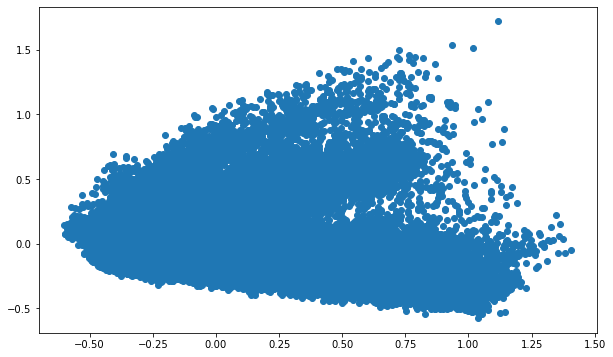

In [54]:
plt.figure(figsize=(10,6))
plt.scatter(x_pca[:, 0], x_pca[:, 1])

## Plot The Elbow Graph For K-Means

In [55]:
model_value = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(x_pca)
    model_value.append(kmeanModel.inertia_)

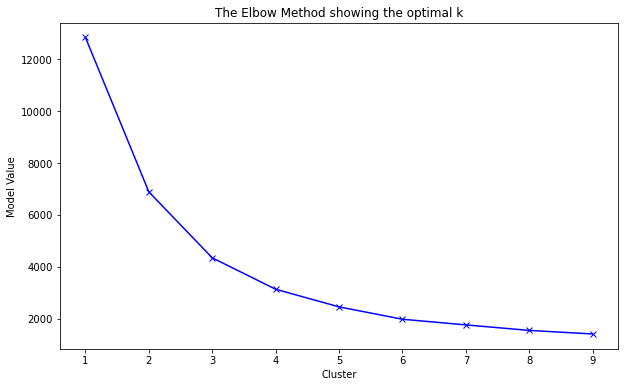

In [56]:
plt.figure(figsize=(10,6))
plt.plot(K, model_value, 'bx-')
plt.xlabel('Cluster')
plt.ylabel('Model Value')
plt.title('The Elbow Method showing the optimal k')
plt.show()

### Applying K Means For Clustering

In [57]:
kmeans = KMeans(n_clusters=2)
y_pred=kmeans.fit_predict(x_pca)

### Plot the cluster on the scatter Plot After K Mean and PCA

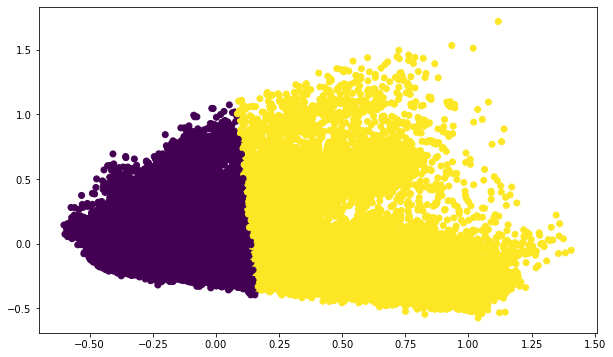

In [58]:
plt.figure(figsize=(10,6))
plt.scatter(x_pca[:, 0], x_pca[:, 1],c=y_pred)

### Adjusted Rand Score For Prediction

In [59]:
score = adjusted_rand_score(y_copy, y_pred)
score

C:\Users\Patrick-Pc\anaconda3\lib\site-packages\sklearn\metrics\cluster\_supervised.py:390: RuntimeWarning: overflow encountered in longlong_scalars
  (tp + fp) * (fp + tn))


0.06504112373416086

### Find The Silhoutte Score Of The Prediction

In [60]:
print('Silhoutte score of our model is ' + str(silhouette_score(x_pca,y_pred)))

Silhoutte score of our model is 0.49728016044752477
